# scCrossTalk tutorial

### General usage
[1] For scRNA-seq data, we suggest to revise the gene symbols with `rev_gene()`. `geneinfo` is the system data.frame containing the information of human and mouse from NCBI gene(updated in June. 19, 2022). To use your own `geneinfo` data.frame, please refer to `demo_geneinfo()` to build a new one, e.g., rat, zebrafish, Drosophila, C. elegans, etc.

In [1]:
library(scCrossTalk)
load(paste0(system.file(package = "scCrossTalk"), "/extdata/example.rda"))

# demo_geneinfo
demo_geneinfo()

# demo_sc_data
demo_sc_data()

# revise gene symbols
sc_data <- rev_gene(data = sc_data,data_type = "count",species = "Human",geneinfo = geneinfo)

symbol,synonyms,species
<chr>,<chr>,<chr>
A1BG,A1B,Human
A1BG,ABG,Human
A2MP1,A2MP,Human
Aco1,Aco,Mouse


6 x 6 sparse Matrix of class "dgCMatrix"
     cell1 cell2 cell3 cell4 cell5 cell6
A1BG     4     .     .     .    24     .
A2M      .     .    21     .     .     .
A2MP    15    37     6     .     .     .
NAT1     .    35    40    17     .    34
NAT2     .    42     .     .    26    42
NATP    44     .     .     .     .     1

[2] create scCrossTalk object with `create_scCrossTalk()`. Users need to provide the raw count data and the cell type. scCrossTalk will use `NormalizeData()` in `Seurat` to normalize data by default. If your data has been normalized by other methods, you can set the parameter `if_normalize = FALSE`

In [2]:
obj <- create_scCrossTalk(sc_data = sc_data, sc_celltype = sc_celltype, species = "Human", if_normalize = TRUE)

# If your data has been normalized by other methods, you can set the parameter `if_normalize = FALSE`

# obj <- create_scCrossTalk(sc_data = sc_data, sc_celltype = sc_celltype,species = "Human", if_normalize = FALSE)

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


[3] find highly expressed LR pairs with `find_lrpairs()`. Users need to provided the speices and lr pairs database. `lrpairs` is the system data.frame containing the known LR pairs of human and mouse from [CellTalkDB](https://pubmed.ncbi.nlm.nih.gov/33147626/). To use your own lrpairs data.frame, please refer to `demo_lrpairs()` to build a new one, e.g., rat, zebrafish, Drosophila, C. elegans, etc.

In [3]:
# demo_lrpairs
demo_lrpairs()

# find highly expressed LR pairs
obj <- find_lrpairs(object = obj, lrpairs = lrpairs, min_cell_num = 10, cell_min_pct = 0.1, p_value = 0.05)

# results is stored in obj@cci
cci <- obj@cci
head(cci)

ligand,receptor,species
<chr>,<chr>,<chr>
CX3CL1,CX3CR1,Human
TGFB1,TGFBR2,Human
CCL2,CCR2,Human
Sst,Sstr1,Mouse


Finding highly expressed LR pairs 



[+>----------------------------] Finished:  6% time:00:00:03

[+>----------------------------] Finished:  8% time:00:00:04

[++>---------------------------] Finished: 11% time:00:00:06

[+++>--------------------------] Finished: 14% time:00:00:07

[++++>-------------------------] Finished: 17% time:00:00:08

[+++++>------------------------] Finished: 19% time:00:00:11

[++++++>-----------------------] Finished: 22% time:00:00:14

[+++++++>----------------------] Finished: 25% time:00:00:17

[+++++++>----------------------] Finished: 28% time:00:00:19

[++++++++>---------------------] Finished: 31% time:00:00:21

[+++++++++>--------------------] Finished: 33% time:00:00:23

[++++++++++>-------------------] Finished: 36% time:00:00:25

[+++++++++++>------------------] Finished: 39% time:00:00:27

[+++++++++++>------------------] Finished: 42% time:00:00:28

[++++++++++++>-----------------] Finished: 44% time:00:00:29

[+++++++++++++>----------------] Finished: 47% time:00:00:30

[++++++

,celltype_sender,celltype_receiver,ligand,receptor,ligand_pct,ligand_exp_avg,ligand_z_score,ligand_p_value,receptor_pct,receptor_exp_avg,receptor_z_score,score
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,acinar_cell,acinar_cell,VIM,CD44,0.6155718,0.8339240,2.611653,0.004505282,0.9075426,2.2410825,7.678032,1.8688924
2,acinar_cell,acinar_cell,C3,CD46,0.5255474,0.8740566,2.756148,0.002924328,0.8077859,0.8377001,2.625249,0.7321973
3,acinar_cell,acinar_cell,CXCL12,ITGB1,0.6496350,0.6158164,1.826372,0.033897157,0.7883212,0.6926912,2.103154,0.4265706
4,acinar_cell,acinar_cell,LMAN1,MCFD2,0.8199513,0.7800645,2.417736,0.007808710,0.8223844,0.9291400,2.954472,0.7247891
5,acinar_cell,acinar_cell,CXCL12,SDC4,0.6496350,0.6158164,1.826372,0.033897157,0.7737226,0.7283321,2.231477,0.4485189
6,acinar_cell,alpha_cell,C3,CD46,0.5255474,0.8740566,2.756148,0.002924328,0.9227683,1.6624160,5.250688,1.4530456


[4] Visualize the cell-cell communications with `plot_cci_chord()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot by order. Default is to plot all cell types
- `celltype_color` Colors for the cell types, whose length must be equal to `celltype`
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `edge_color` Colors for the edges from the sender cell type, whose length must be equal to celltype
- `edge_type` Types for the edges from the sender cell type. Default is "big.arrow". "ellipse" for ellipse, "triangle" for triangle, "curved" for curved. Details see `circlize::chordDiagram`
- `show_type` which type to show, \code{"number"} and \code{"score"} for sum of inferred LR number and score, respectively. Default is \code{"number"}
- `if_show_autocrine` Whether to show autocrine. Default is \code{FALSE}
- `text_size` Size of text labels. Default is \code{1.5}
- `y_scale` y_scale to adjust the text. Default is \code{0.1}
- `...` parameters pass to `circlize::chordDiagram`, e.g., `link.arr.width`, `link.arr.length`, `link.arr.col`

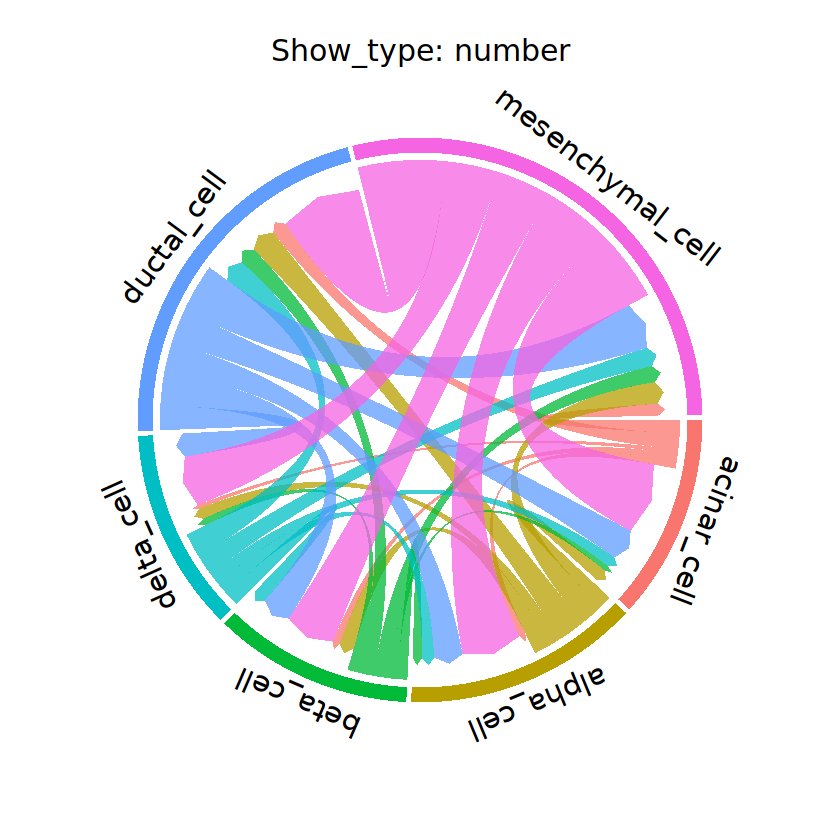

In [4]:
plot_cci_chord(object = obj)

[5] Visualize the cell-cell communications with `plot_cci_circle()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot. Default is to plot all cell types
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `celltype_color` Colors for the cell types, whose length must be equal to `celltype`
- `edge_color` Colors for the edges from the sender cell type, whose length must be equal to `celltype`
- `edge_type` Types for the edges. "fan" by default, "link", "hive"
- `show_type` which type to show, "number" and "score" for sum of inferred LR number and score, respectively. Default is "number"
- `if_show_autocrine` Whether to show autocrine. Default is `FALSE`
- `edge_alpha` Transparency of edge. Default is 0.5
- `node_size` Size of node. Default is 10
- `text_size` Size of text. Default is 5

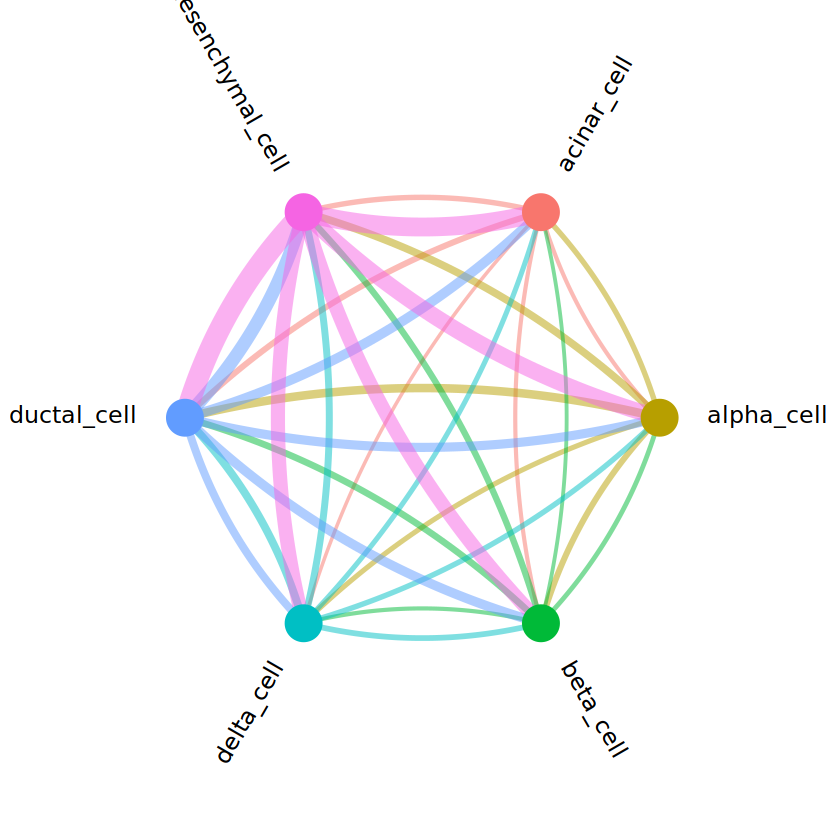

In [5]:
plot_cci_circle(object = obj)

### Note
To show one or more senders or receivers by retaining all cell types, users can use `plot_cci_circle_simple()` for plotting.

[6] Visualize the cell-cell communications with `plot_cci_circle_simple()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot. one or more cell types
- `celltype_dir` which direction to plot, "sender" or "receiver". Default is as "sender"
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `celltype_color` Colors for the cell types, whose length must be equal to `celltype`
- `edge_color` Colors for the edges from the sender cell type, whose length must be equal to `celltype`
- `edge_type` Types for the edges. "fan" by default, "link", "hive"
- `show_type` which type to show, "number" and "score" for sum of inferred LR number and score, respectively. Default is "number"
- `if_show_autocrine` Whether to show autocrine. Default is `FALSE`
- `edge_alpha` Transparency of edge. Default is 0.5
- `node_size` Size of node. Default is 10
- `text_size` Size of text. Default is 5

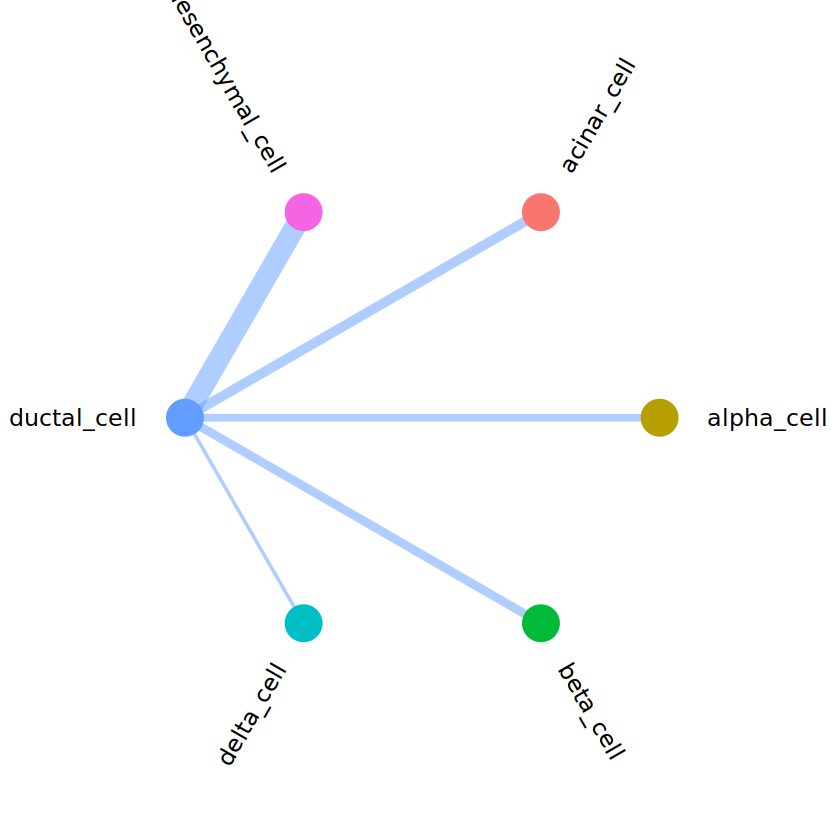

In [6]:
plot_cci_circle_simple(object = obj, celltype = "ductal_cell", celltype_dir = "sender")

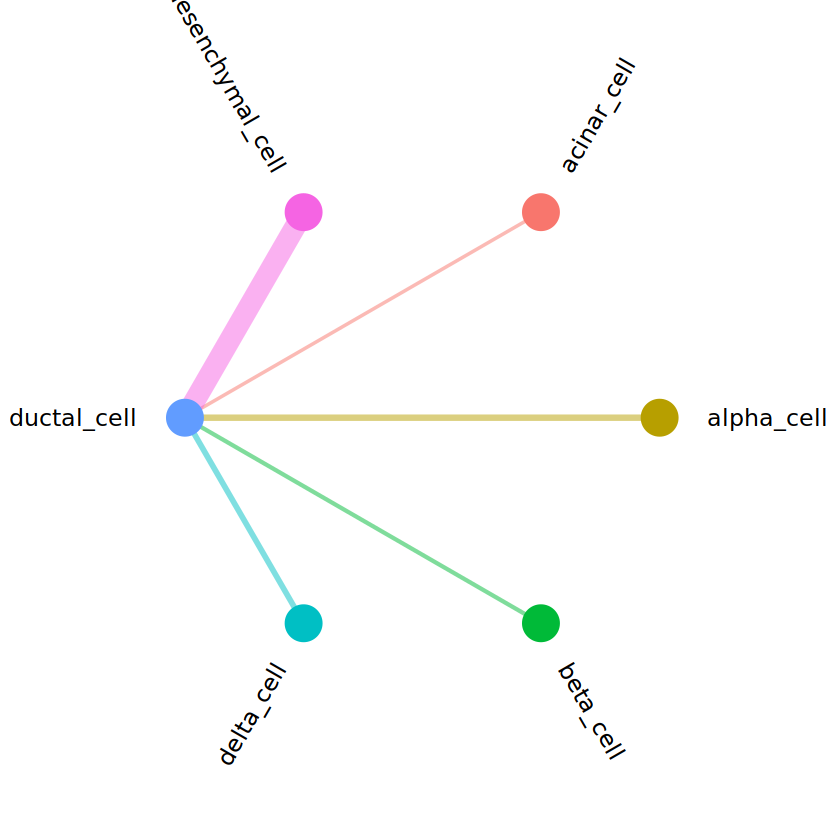

In [7]:
plot_cci_circle_simple(object = obj, celltype = "ductal_cell", celltype_dir = "reciver")

[7] Visualize the cell-cell communications with `plot_cci_heatmap()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot. Default is to plot all cell types
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `celltype_color` Colors for the cell types, whose length must be equal to `celltype`
- `edge_color` Colors for the edges from the sender cell type, whose length must be equal to `celltype`, or use "NO" to cancel it
- `show_type` which type to show, "number" and "score" for sum of inferred LR number and score, respectively. Default is "number"
- `if_show_autocrine` Whether to show autocrine. Default is `FALSE`
- `edge_alpha` Transparency of edge. Default is 0.5
- `node_size` Size of node. Default is 40
- `text_size` Size of text. Default is 15
- `node_pad` Size of node padding. Numeric essentially influences the width height. Default is 20
- `...` parameters pass to `networkD3::sankeyNetwork`

In [8]:
plot_cci_heatmap(object = obj)

HTML widgets cannot be represented in plain text (need html)

[8] Visualize the cell-cell communications with `plot_cci_sankey()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot by order. Default is to plot all cell types
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `show_type` which type to show, "number" and "score" for sum of inferred LR number and score, respectively. Default is "number"
- `text_size` Size of text labels. Default is 10
- `viridis_option` option in `viridis::scale_color_viridis`, can be "A", "B", "C", "D", "E", "F", "G", "H". Default is "D".
- `...` parameters pass to `heatmaply::heatmaply`, e.g., grid_color

In [9]:
plot_cci_sankey(object = obj)

HTML widgets cannot be represented in plain text (need html)

[9] Visualize the LR interactions with `plot_cci_lrpairs_heatmap()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot. Default is to plot all cell types
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `if_show_autocrine` Whether to show autocrine. Default is `FALSE`
- `if_horizontal` Whether to plot with the horizontal direction. Default is `TRUE`
- `text_size` Size of text labels. Default is 10
- `viridis_option` option in `viridis::scale_color_viridis`, can be "A", "B", "C", "D", "E", "F", "G", "H". Default is "D".
- `...` parameters pass to `heatmaply::heatmaply`, e.g., grid_color

In [10]:
plot_cci_lrpairs_heatmap(object = obj)

HTML widgets cannot be represented in plain text (need html)

[10] Visualize the LR interactions with `plot_cci_lrpairs_bubble()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype` which cell types to plot. Default is to plot all cell types
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `if_show_autocrine` Whether to show autocrine. Default is `FALSE`
- `if_horizontal` Whether to plot with the horizontal direction. Default is `TRUE`
- `size` Size of the bubble. Default is 2
- `viridis_option` option in `viridis::scale_color_viridis`, can be "A", "B", "C", "D", "E", "F", "G", "H". Default is "D".

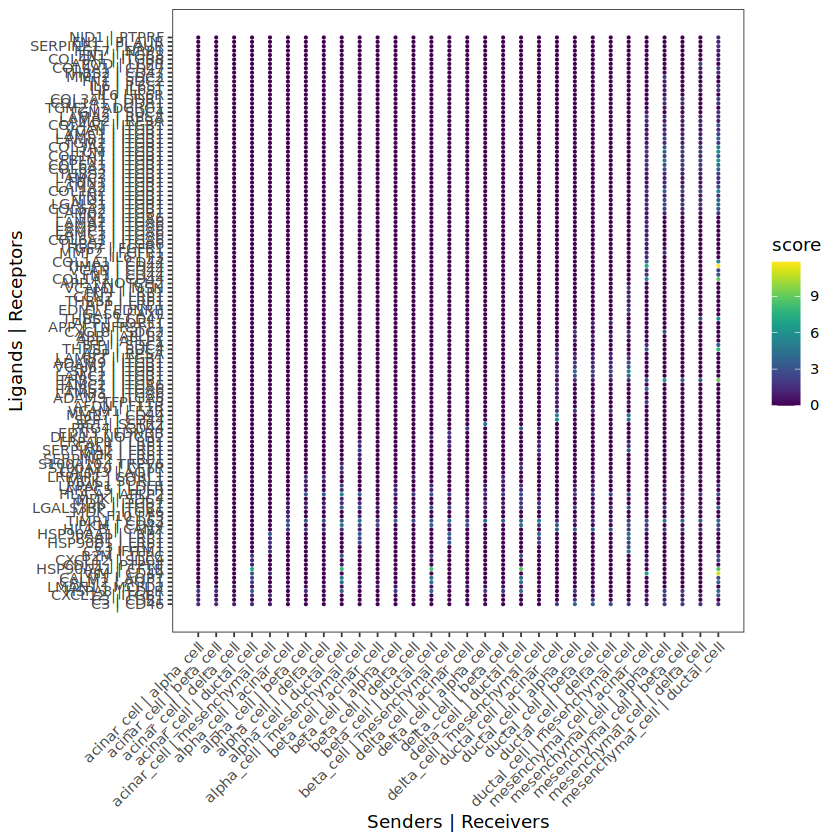

In [11]:
plot_cci_lrpairs_bubble(object = obj, size = 0.5, if_horizontal = FALSE)

### Note
To filter the top LR interactions, users can use `get_top_lrpairs()` for plotting

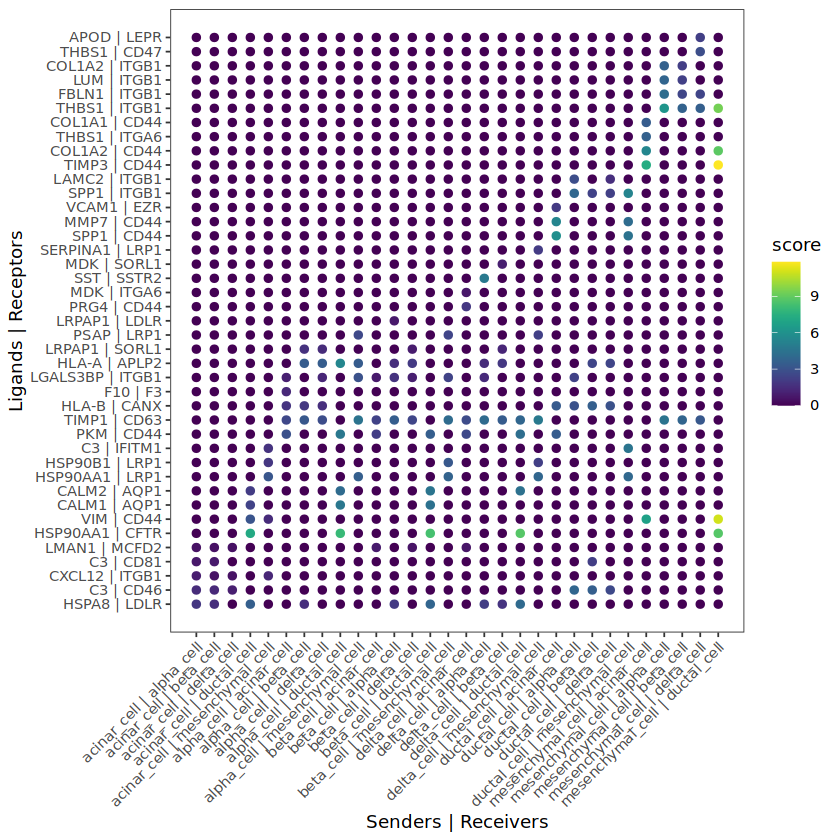

In [12]:
obj_filter <- obj
obj_filter@cci <- get_top_lrpairs(object = obj_filter, top_n = 5)
plot_cci_lrpairs_bubble(object = obj_filter, size = 2, if_horizontal = FALSE)

In [13]:
plot_cci_lrpairs_heatmap(object = obj_filter, celltype = c("alpha_cell","beta_cell", "delta_cell", "ductal_cell"))

HTML widgets cannot be represented in plain text (need html)

[11] Visualize the LR interactions with `plot_lrpairs_chord()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype_sender` Name of celltype_sender. One or more cell types
- `celltype_receiver` Name of celltype_receiver. One or more cell types
- `celltype_color` Colors for the celltype_sender nodes and celltype_receiver nodes, or use "NO" to make it simple
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `edge_color` Colors for the edges from the sender cell type
- `edge_type` Types for the edges from the sender cell type. Default is "circle", "big.arrow" for big arrow, "triangle" for triangle, "ellipse" for ellipse, "curved" for curved. Details see `circlize::chordDiagram`
- `text_size` Size of text labels. Default is 0.5
- `y_scale` y_scale to adjust the text. Default is 1
- `...` parameters pass to `circlize::chordDiagram`, e.g., `link.arr.width`, `link.arr.length`, `link.arr.col`

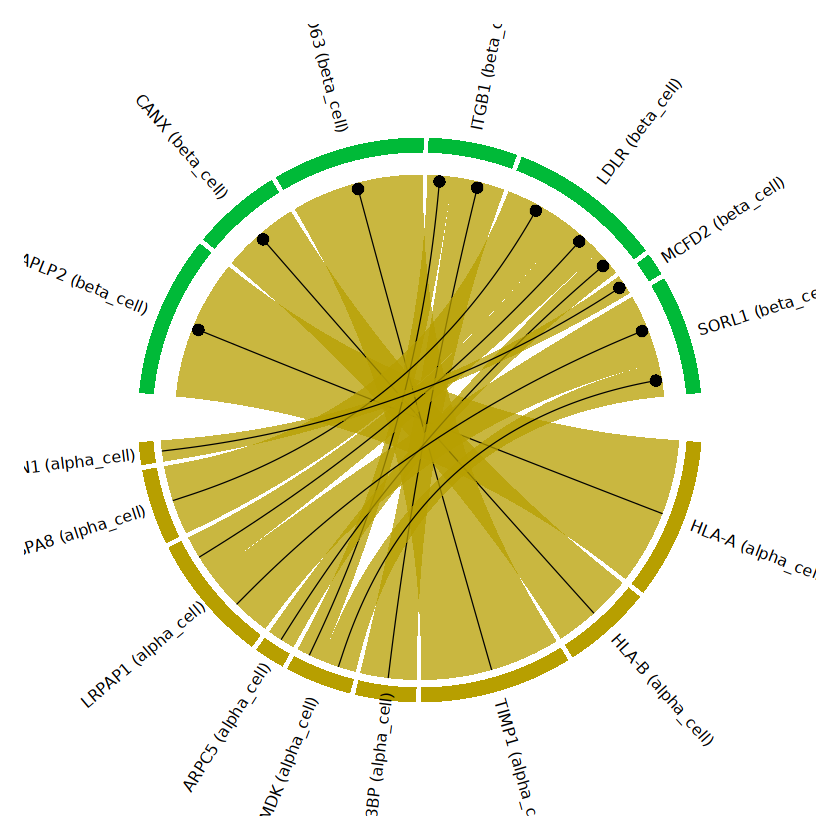

In [14]:
plot_lrpairs_chord(obj,celltype_sender = "alpha_cell",celltype_receiver = "beta_cell",link.arr.width = 0.5, link.arr.length = 0.2, text_size = 0.8)

[12] Visualize the LR interactions with `plot_lrpairs_heatmap()`, parameters see below:

- `object` scCrossTalk object after `find_lrpairs`
- `celltype_sender` Name of celltype_sender. One or more cell types
- `celltype_receiver` Name of celltype_receiver. One or more cell types
- `ligand` which ligand to use. Default is to plot all inferred ligands
- `receptor` which receptor to use. Default is to plot all inferred receptors
- `text_size` Size of text labels. Default is 3
- `if_horizontal` Whether to plot with the horizontal direction. Default is `TRUE`
- `viridis_option` option in `viridis::scale_color_viridis`, can be "A", "B", "C", "D", "E", "F", "G", "H". Default is "D".
- `...` parameters pass to `heatmaply::heatmaply`, e.g., grid_color

In [15]:
plot_lrpairs_heatmap(obj,celltype_sender = "alpha_cell",celltype_receiver = "beta_cell")

HTML widgets cannot be represented in plain text (need html)

In [16]:
sessionInfo()

R version 4.1.3 (2022-03-10)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: CentOS Linux 7 (Core)

Matrix products: default
BLAS/LAPACK: /slurm/users/shaoxin/anaconda3/envs/r-base-4.1.3/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=zh_CN.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=zh_CN.UTF-8        LC_COLLATE=zh_CN.UTF-8    
 [5] LC_MONETARY=zh_CN.UTF-8    LC_MESSAGES=zh_CN.UTF-8   
 [7] LC_PAPER=zh_CN.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=zh_CN.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
[1] scCrossTalk_1.0 repr_1.1.6     

loaded via a namespace (and not attached):
  [1] Seurat_4.3.0           Rtsne_0.16             colorspace_2.1-0      
  [4] deldir_1.0-6           ellipsis_0.3.2         ggridges_0.5.4        
  [7] circlize_0.4.15        IRdisplay_1.1          Global